##CS435 - Deep Learning with Computer Vision Applications 
#Image Processing - Practical 

1. Image read and display

In [ ]:
import imageio as iio


In [ ]:
# read an image
img = iio.imread("cat_image.jpg")
 
# write it in a new format
iio.imwrite("cat_image_copy.jpg", img)

In [ ]:
# Python program to read image using OpenCV

# importing OpenCV(cv2) module
import cv2
from google.colab.patches import cv2_imshow

# Save image in set directory
# Read RGB image
img = cv2.imread('cat_image_copy.jpg')

# Output img with window name as 'image'
cv2_imshow(img)

# Maintain output window utill
# user presses a key
#cv2.waitKey(0)	

# Destroying present windows on screen
#cv2.destroyAllWindows()


2. Second way to read and display images 

In [ ]:
# Python program to read
# image using PIL module

# importing PIL
from PIL import Image

# Read image
img = Image.open('cat_image_copy.jpg')

# Output Images
img.show()# show(img)

# prints format of image
print(img.format)

# prints mode of image
print(img.mode)


In [ ]:
#few other imports 
from skimage import io
from PIL import Image 
import matplotlib.pylab as plt

In [ ]:
# Create a list to store the urls of the images
urls = ["https://iiif.lib.ncsu.edu/iiif/0052574/full/800,/0/default.jpg",
       "https://iiif.lib.ncsu.edu/iiif/0016007/full/800,/0/default.jpg",
      "https://placekitten.com/800/571"]  
# Read and display the image
# loop over the image URLs, you could store several image urls in the list

for url in urls:
  image = io.imread(url) 
  image_2 = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
  final_frame = cv2.hconcat((image, image_2))
  cv2_imshow(final_frame)
  print('\n')

3. Image Contours and Histograms

In [ ]:
# Check the image matrix data type (could know the bit depth of the image)
print(image.dtype)
# Check the height of image 
print(image.shape[0])
# Check the width of image 
print(image.shape[1])
# Check the number of channels of the image
print(image.shape[2])

4. Generate Histogram of color image and grayscale image

In [ ]:
plt.hist(image.ravel(),bins = 256, range = [0,256]) 
plt.show()

5. Color Histrogram 

In [ ]:
color = ('b','g','r')
for i,col in enumerate(color):
    histr = cv2.calcHist([image],[i],None,[256],[0,256])
    plt.plot(histr,color = col)
    plt.xlim([0,256])
plt.show()

6. Gray image from colored image 

In [ ]:
gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
cv2_imshow(gray_image)

In [ ]:
plt.hist(gray_image.ravel(),bins = 256, range = [0, 256])
plt.show()

#check seperatly 
plt.hist(image[2].ravel(),bins = 256, range = [0, 256])
plt.show()

# Image contour of the grayscale image

In [ ]:
plt.contour(gray_image, origin = "image")

In [ ]:
# Set threshold for the countour detection
ret, thresh = cv2.threshold(gray_image,150,255,0)
contours, hierarchy = cv2.findContours(thresh, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
cv2.drawContours(image, contours, -1, (0, 255, 0), 3)
plt.imshow(image)

In [ ]:
### TODO # 3: Find the contour of your own image


###Grayscale Transform and Histogram Equalization

In [ ]:
im2 = 255 - gray_image
cv2_imshow(im2)

In [ ]:
im3 = (100.0/255)*gray_image + 100
cv2_imshow(im3)

In [ ]:
# The lightness level of the gray_image decreases after this step
im4 = 255.0*(gray_image/255.0)**2
cv2_imshow(im4)

In [ ]:
#TODO #4: Try some mathematical operations on your image

#Histogram Equalization

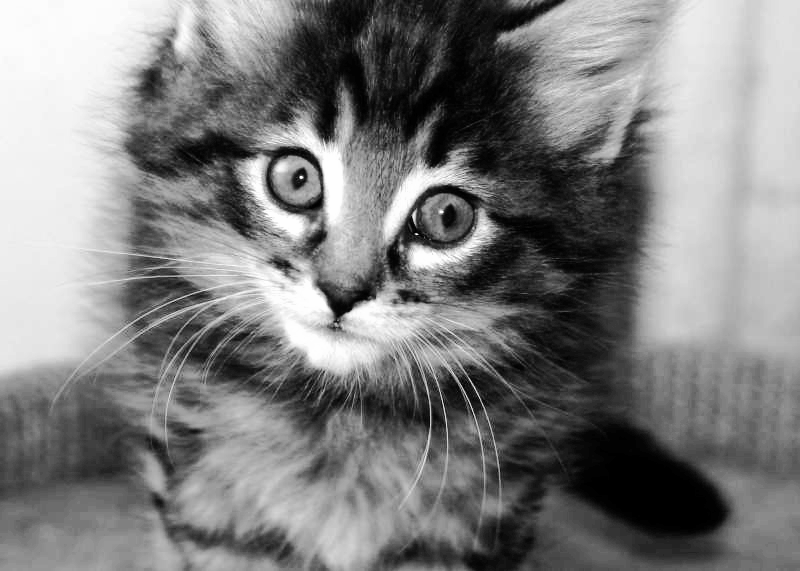

In [43]:
import numpy as np 
# function of histogram equalization
def histeq(im, nbr_bins = 256):
  """ Histogram equalization of a grayscale image.  """
  # get the image histogram
  imhist, bins = np.histogram(im.flatten(), nbr_bins, [0, 256])
  cdf = imhist.cumsum() # cumulative distribution function
  cdf = imhist.max()*cdf/cdf.max()  #normalize
  cdf_mask = np.ma.masked_equal(cdf, 0)
  cdf_mask = (cdf_mask - cdf_mask.min())*255/(cdf_mask.max()-cdf_mask.min())
  cdf = np.ma.filled(cdf_mask,0).astype('uint8')
  return cdf[im.astype('uint8')]

# apply the function on your dark image to increase the contrast
# we could observe that the contrast of the black background has increased
im5 = histeq(im4)
cv2_imshow(im5)

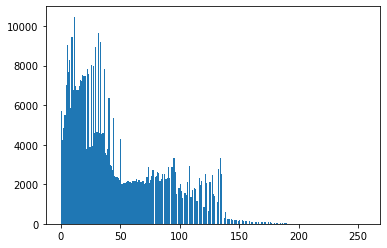

In [44]:
# Before histogram equalization
plt.hist(im4.ravel(),bins = 256, range = [0, 256])
plt.show()

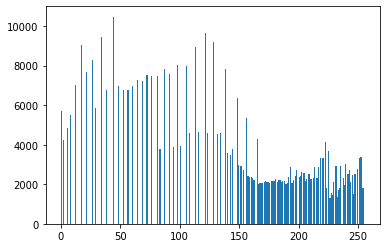

In [45]:
# After histogram equalization
plt.hist(im5.ravel(),bins = 256, range = [0, 256])
plt.show()

In [ ]:
#TODO # 5: Do a histogram equalization on your grayscale image

#Fourier Transform of Gray Images

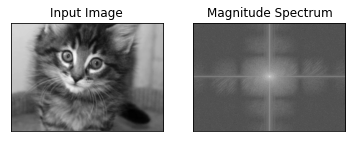

In [47]:
# Blur the grayscale image by a Guassian filter with kernel size of 10
imBlur = cv2.blur(gray_image,(5,5))
# Transform the image to frequency domain
f = np.fft.fft2(imBlur)
# Bring the zero-frequency component to the center
fshift = np.fft.fftshift(f)
magnitude_spectrum = 30*np.log(np.abs(fshift))

plt.subplot(121),plt.imshow(imBlur, cmap = 'gray')
plt.title('Input Image'), plt.xticks([]), plt.yticks([])
plt.subplot(122),plt.imshow(magnitude_spectrum, cmap = 'gray')
plt.title('Magnitude Spectrum'), plt.xticks([]), plt.yticks([])
plt.show()

In [ ]:
#TODO # 6: Generate a fourier transform of your grayscale image

#Highpass Filtering in FFT

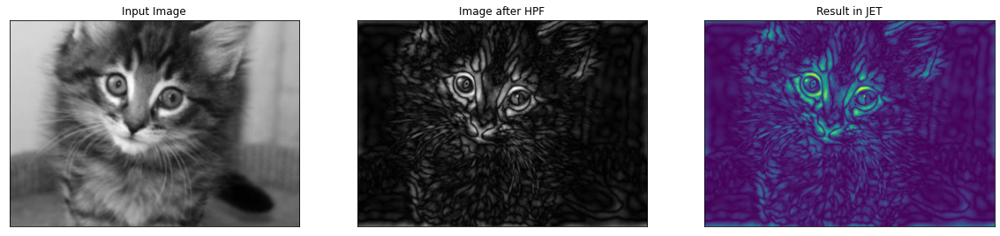

In [48]:
rows, cols = imBlur.shape
crow,ccol = round(rows/2) , round(cols/2)
# remove low frequencies with a rectangle size of 10
fshift[crow-10:crow+10, ccol-10:ccol+10] = 0
f_ishift = np.fft.ifftshift(fshift)
img_back = np.fft.ifft2(f_ishift)
img_back = np.abs(img_back)

plt.figure(figsize=([20, 20]))
plt.subplot(131),plt.imshow(imBlur, cmap = 'gray')
plt.title('Input Image'), plt.xticks([]), plt.yticks([])
plt.subplot(132),plt.imshow(img_back, cmap = 'gray')
plt.title('Image after HPF'), plt.xticks([]), plt.yticks([])
plt.subplot(133),plt.imshow(img_back)
plt.title('Result in JET'), plt.xticks([]), plt.yticks([])
plt.show()

#Interpolating while displaying with matplotlib imshow


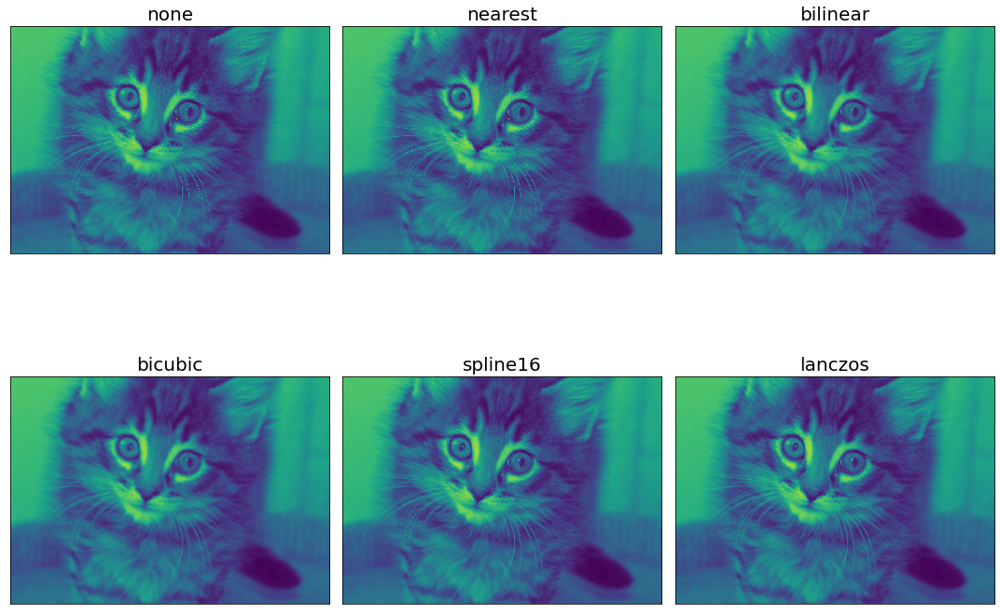

In [50]:
im = gray_image
methods = ['none', 'nearest', 'bilinear', 'bicubic', 'spline16', 'lanczos']
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(15, 12), subplot_kw={'xticks': [], 'yticks': []})
fig.subplots_adjust(hspace=0.05, wspace=0.05)
for ax, interp_method in zip(axes.flat, methods):
    ax.imshow(im, interpolation=interp_method)
    ax.set_title(str(interp_method), size=20)
plt.tight_layout()
plt.show()

In [53]:
#if needed 
from skimage import color, viewer, exposure, img_as_float, data


<ipython-input-53-7c4466ecd7e5>:2: UserWarning: Viewer requires Qt
  from skimage import color, viewer, exposure, img_as_float, data


<Figure size 432x288 with 0 Axes>

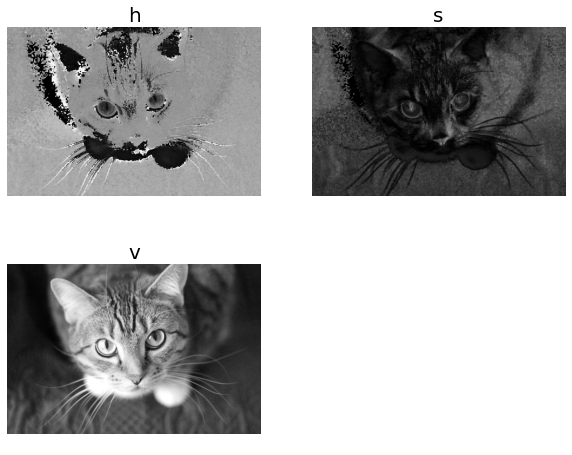

In [54]:
im = cv2.imread('cat_image_copy.jpg')
im_hsv = color.rgb2hsv(im)
plt.gray()
plt.figure(figsize=(10,8))
plt.subplot(221), plt.imshow(im_hsv[...,0]), plt.title('h', size=20),
plt.axis('off')
plt.subplot(222), plt.imshow(im_hsv[...,1]), plt.title('s', size=20),
plt.axis('off')
plt.subplot(223), plt.imshow(im_hsv[...,2]), plt.title('v', size=20),
plt.axis('off')
plt.subplot(224), plt.axis('off')
plt.show()

<class 'numpy.ndarray'>
Shape of the image (2304, 3456, 3)


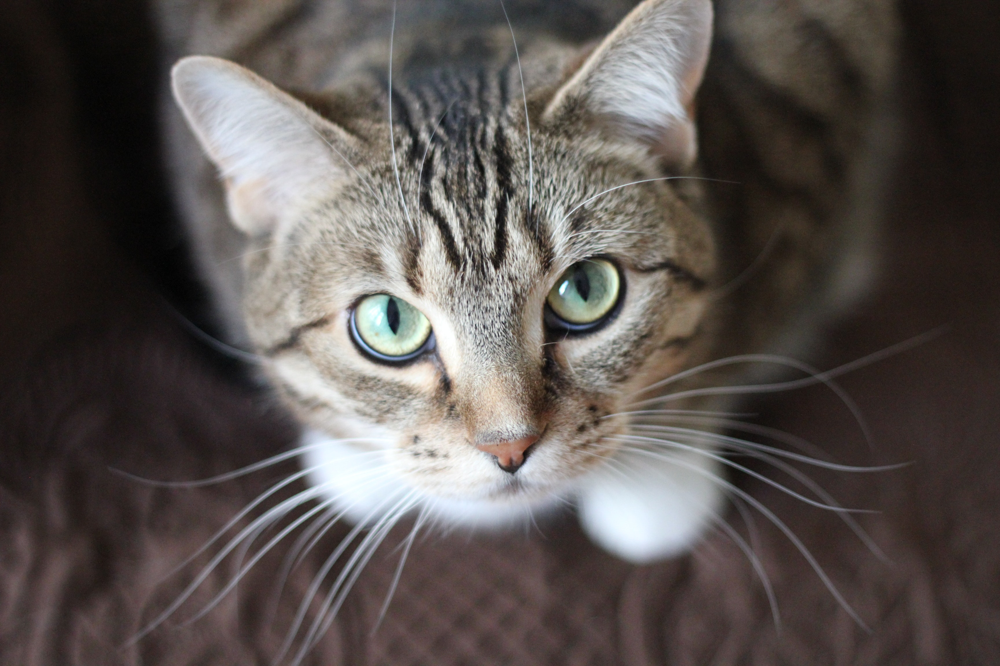

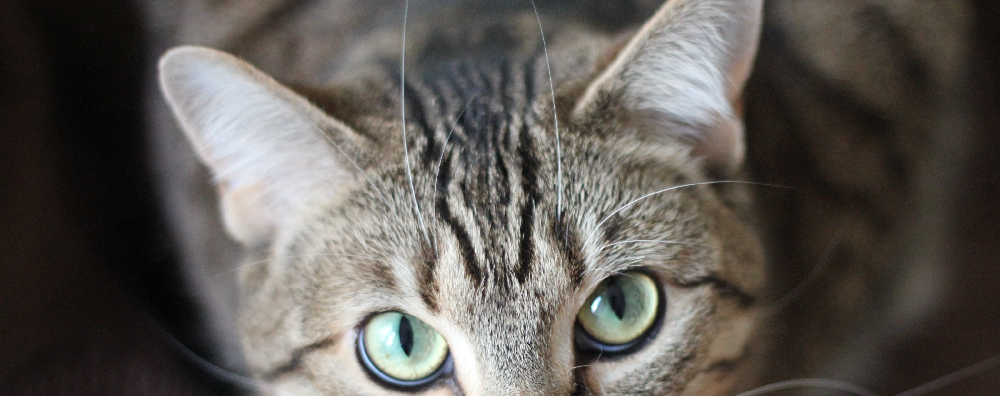

In [62]:
 
img = cv2.imread("cat_image.jpg")
print(type(img))
  
# Shape of the image
print("Shape of the image", img.shape)
  
# [rows, columns]
crop = img[50:1280, 100:3200]  
  
cv2_imshow(img)
cv2_imshow(crop)


In [61]:
print(img)

[[[20 23 28]
  [21 24 29]
  [19 22 27]
  ...
  [16 17 21]
  [15 16 20]
  [16 17 21]]

 [[19 22 27]
  [20 23 28]
  [19 22 27]
  ...
  [18 19 23]
  [19 20 24]
  [19 20 24]]

 [[18 21 26]
  [19 22 27]
  [19 22 27]
  ...
  [18 21 25]
  [19 22 26]
  [19 22 26]]

 ...

 [[55 55 71]
  [55 55 71]
  [52 52 68]
  ...
  [48 51 59]
  [47 50 58]
  [43 46 54]]

 [[59 57 76]
  [58 56 75]
  [55 53 72]
  ...
  [44 46 56]
  [44 46 56]
  [44 46 56]]

 [[59 57 76]
  [59 57 76]
  [56 54 73]
  ...
  [40 42 52]
  [42 44 54]
  [45 47 57]]]


#difference between resize and crop ?? 

(2304, 3456, 3) (1610, 1050, 3)


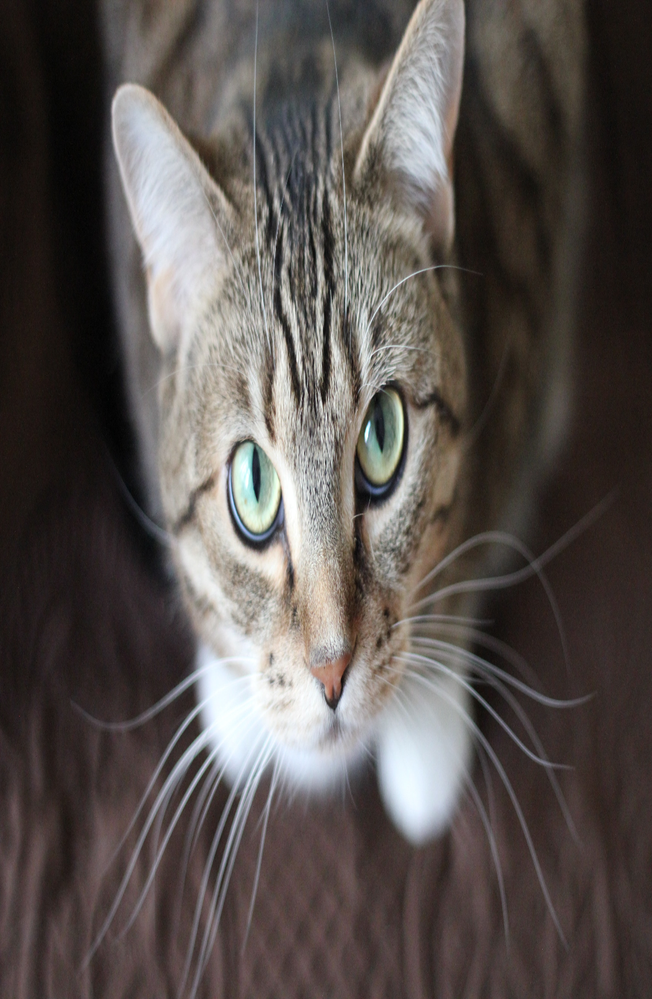

In [63]:
img_resize = cv2.resize(img, (1050, 1610))
print(img.shape, img_resize.shape)
cv2_imshow(img_resize)

#Applying an Affine transformation on an image


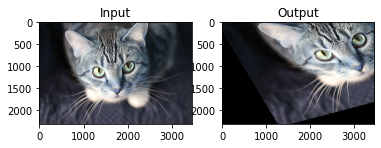

In [89]:
img = cv2.imread('cat_image.jpg')

rows, cols, ch = img.shape
  
pts1 = np.float32([[50, 50],
                   [200, 50], 
                   [50, 200]])
  
pts2 = np.float32([[10, 100],
                   [200, 50], 
                   [100, 250]])
  
M = cv2.getAffineTransform(pts1, pts2)
dst = cv2.warpAffine(img, M, (cols, rows))
  
plt.subplot(121)
plt.imshow(img)
plt.title('Input')
  
plt.subplot(122)
plt.imshow(dst)
plt.title('Output')
  
plt.show()


#Image operations

In [91]:
from PIL.ImageChops import add, subtract, multiply, difference, screen


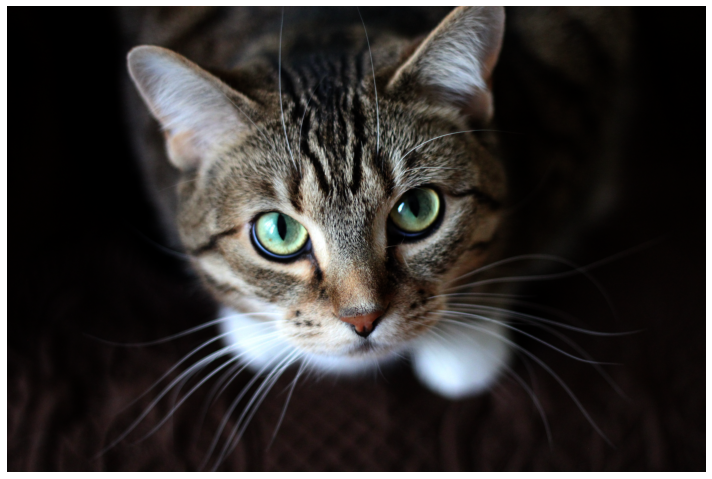

In [108]:
#superimpossing 
img = Image.open("cat_image.jpg") 

im2 = Image.open("cat_image.jpg").convert('RGB').resize((img.width, img.height))

plt.figure(figsize=(10,10))
plt.imshow(multiply(img, im2))
plt.axis('off') # no axis ticks
plt.tight_layout()
plt.show()

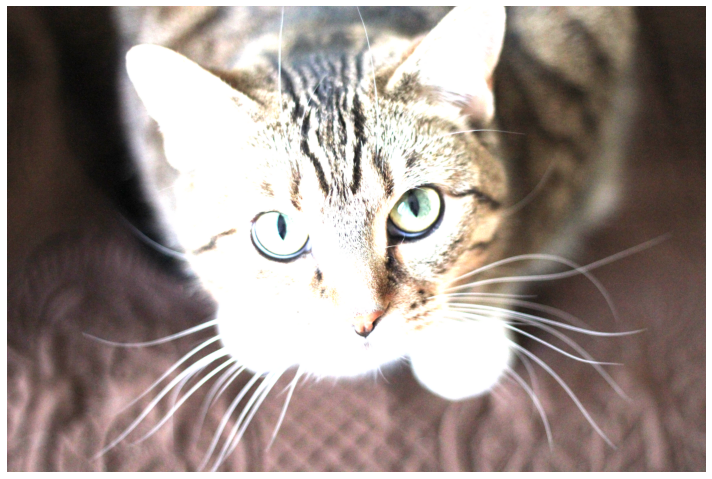

In [109]:
plt.figure(figsize=(10,10))
plt.imshow(add(img, im2))
plt.axis('off') # no axis ticks
plt.tight_layout()
plt.show()

#Applying the swirl transform


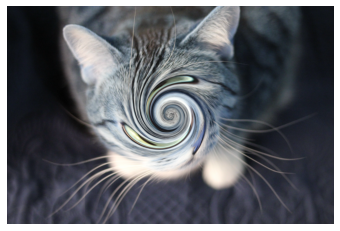

In [135]:
from skimage.transform import swirl
im = cv2.imread("cat_image.jpg")
swirled = swirl(im, rotation=0, strength=15, radius=1000)
plt.imshow(swirled)
plt.axis('off')
plt.show()

##Adding random Gaussian noise to images


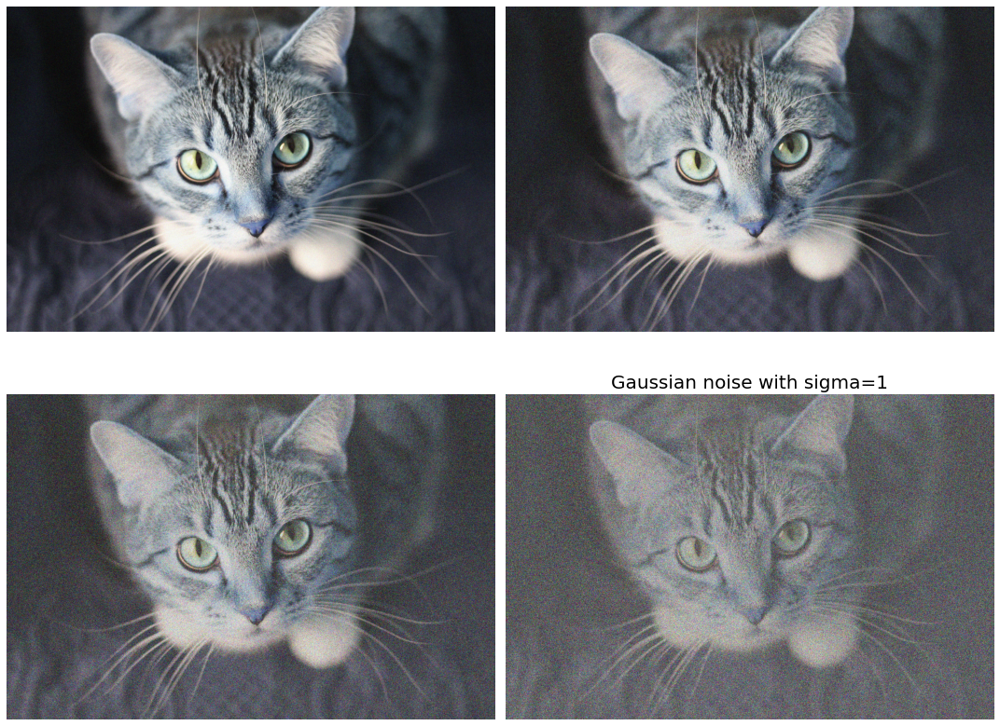

In [136]:
from skimage.util import random_noise

im = img_as_float(cv2.imread("cat_image.jpg"))
plt.figure(figsize=(15,12))
sigmas = [0.1, 0.25, 0.5, 1]
for i in range(4):
    noisy = random_noise(im, var=sigmas[i]**2)
    plt.subplot(2,2,i+1)
    plt.imshow(noisy)
    plt.axis('off')
plt.title('Gaussian noise with sigma=' + str(sigmas[i]), size=20)
plt.tight_layout()
plt.show()

## Sampling 

In [137]:
import matplotlib.pylab as pylab


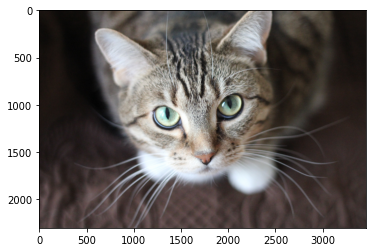

In [138]:
im = Image.open("cat_image.jpg") # the original small clock image
pylab.imshow(im)
pylab.show()

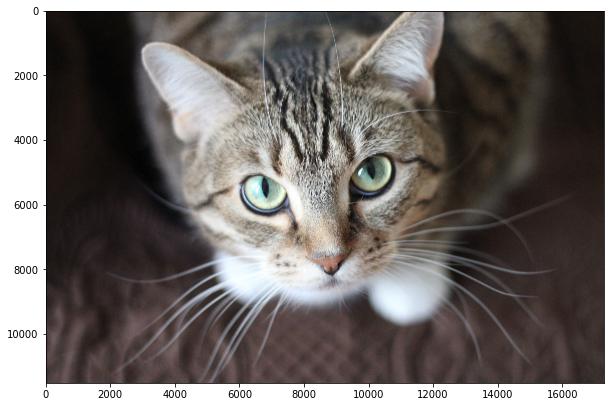

In [139]:
im1 = im.resize((im.width*5, im.height*5), Image.NEAREST) # nearest neighbor interpolation
pylab.figure(figsize=(10,10))
pylab.imshow(im1)
pylab.show()

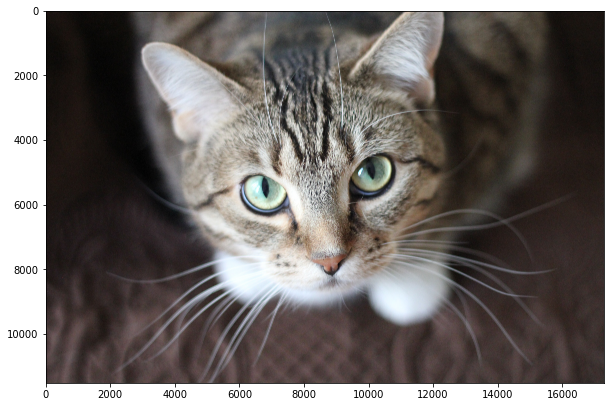

In [140]:
im1 = im.resize((im.width*5, im.height*5), Image.BILINEAR) # up-sample with bi-linear interpolation
pylab.figure(figsize=(10,10))
pylab.imshow(im1)
pylab.show()

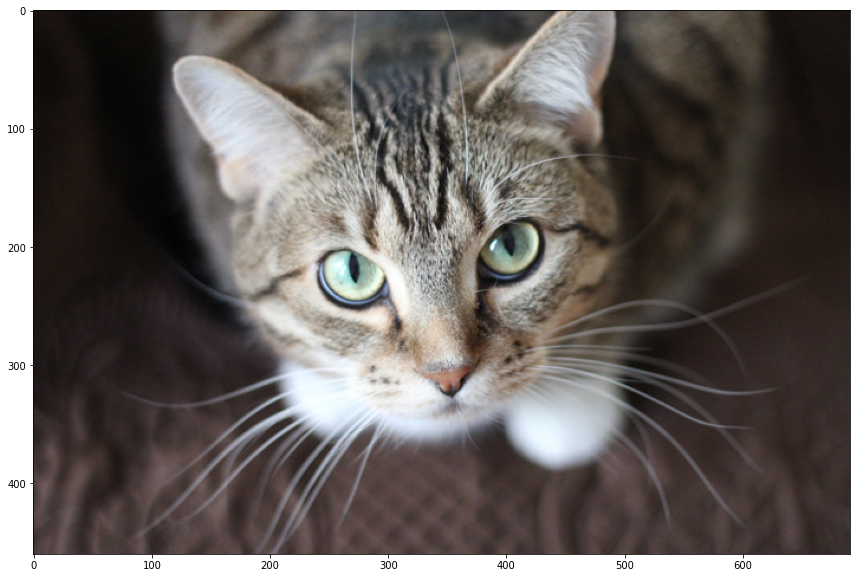

In [141]:
im = im.resize((im.width//5, im.height//5))
pylab.figure(figsize=(15,10))
pylab.imshow(im)
pylab.show()

##Frequency domain Gaussian blur filter with numpy fft


In [142]:
from scipy import ndimage, misc, signal
import numpy.fft
import scipy.fftpack as fp
import matplotlib.pylab as pylab

<ipython-input-143-ccb0866f15e5>:15: ComplexWarning: Casting complex values to real discards the imaginary part
  pylab.subplot(2,3,4), pylab.imshow( (20*np.log10( 0.1 + fp.fftshift(freq))).astype(int))
<ipython-input-143-ccb0866f15e5>:17: ComplexWarning: Casting complex values to real discards the imaginary part
  pylab.subplot(2,3,5), pylab.imshow( (20*np.log10( 0.1 +
<ipython-input-143-ccb0866f15e5>:20: ComplexWarning: Casting complex values to real discards the imaginary part
  pylab.imshow( (20*np.log10( 0.1 + fp.fftshift(convolved))).astype(int))


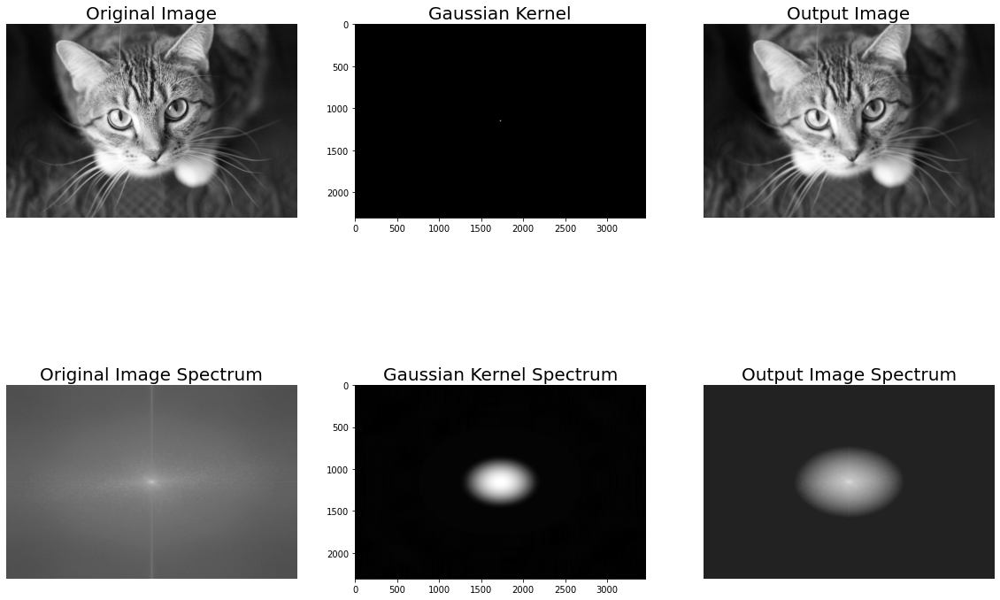

In [143]:
pylab.figure(figsize=(20,15))
pylab.gray() # show the filtered result in grayscale
im = np.mean(cv2.imread('cat_image.jpg'), axis=2)
gauss_kernel = np.outer(signal.gaussian(im.shape[0], 5), signal.gaussian(im.shape[1], 5))
freq = fp.fft2(im)
assert(freq.shape == gauss_kernel.shape)
freq_kernel = fp.fft2(fp.ifftshift(gauss_kernel))
convolved = freq*freq_kernel # by the convolution theorem, simply multiply in the frequency domain
im1 = fp.ifft2(convolved).real
pylab.subplot(2,3,1), pylab.imshow(im), pylab.title('Original Image',
size=20), pylab.axis('off')
pylab.subplot(2,3,2), pylab.imshow(gauss_kernel), pylab.title('Gaussian Kernel', size=20)
pylab.subplot(2,3,3), pylab.imshow(im1) # the imaginary part is an artifact
pylab.title('Output Image', size=20), pylab.axis('off')
pylab.subplot(2,3,4), pylab.imshow( (20*np.log10( 0.1 + fp.fftshift(freq))).astype(int))
pylab.title('Original Image Spectrum', size=20), pylab.axis('off')
pylab.subplot(2,3,5), pylab.imshow( (20*np.log10( 0.1 +
fp.fftshift(freq_kernel))).astype(int))
pylab.title('Gaussian Kernel Spectrum', size=20), pylab.subplot(2,3,6)
pylab.imshow( (20*np.log10( 0.1 + fp.fftshift(convolved))).astype(int))
pylab.title('Output Image Spectrum', size=20), pylab.axis('off')
pylab.subplots_adjust(wspace=0.2, hspace=0)
pylab.show()

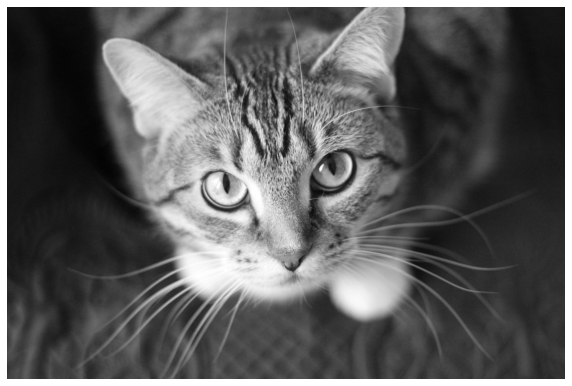

In [144]:
#High-Pass Filter (HPF)

im = np.array(Image.open('cat_image.jpg').convert('L'))
pylab.figure(figsize=(10,10))
pylab.imshow(im, cmap=pylab.cm.gray)
pylab.axis('off')
pylab.show()

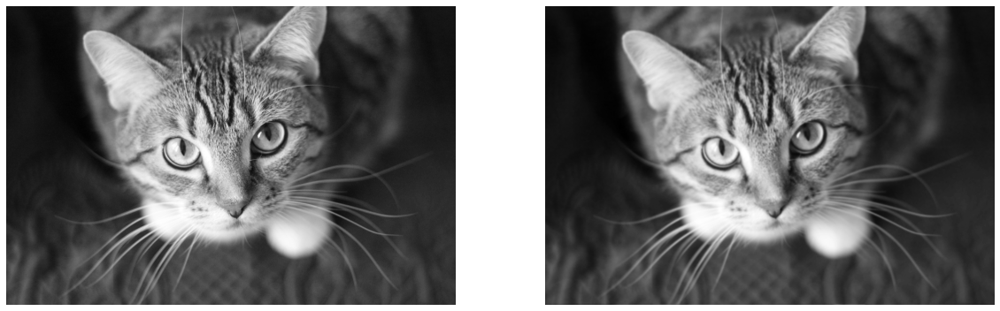

In [146]:
##Low-pass filter 
#import numpy.fft as fp
fig, (axes1, axes2) = pylab.subplots(1, 2, figsize=(20,10))
pylab.gray() # show the result in grayscale
im = np.mean(cv2.imread('cat_image.jpg'), axis=2)
freq = fp.fft2(im)
freq_gaussian = ndimage.fourier_gaussian(freq, sigma=4)
im1 = fp.ifft2(freq_gaussian)
axes1.imshow(im)
axes1.axis('off')
axes2.imshow(im1.real) # the imaginary part is an artifact
axes2.axis('off')
pylab.show()

##TODO Band pass filter on your image 

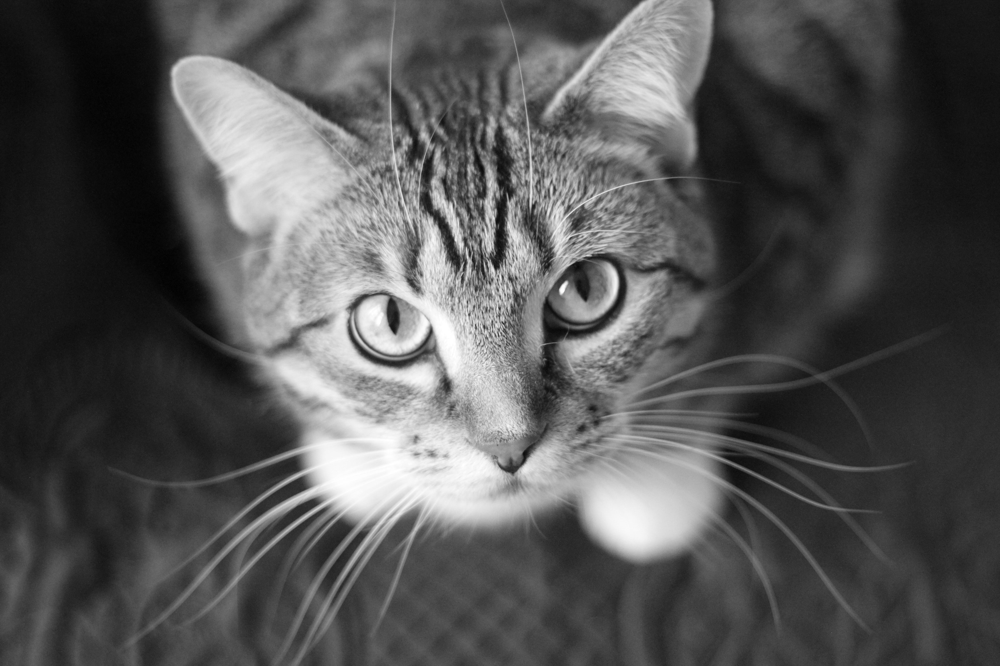

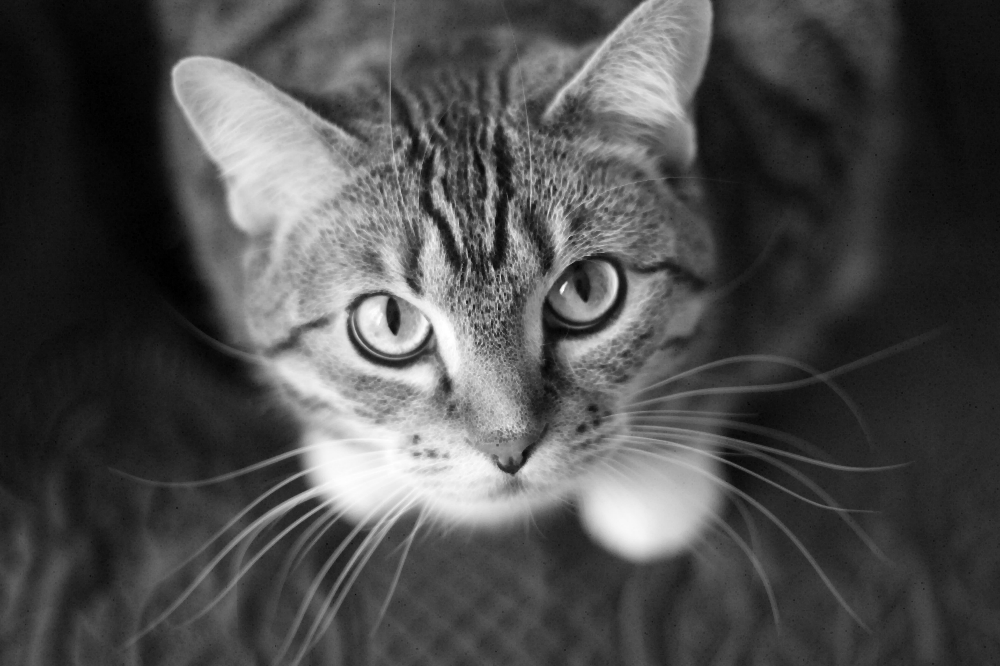

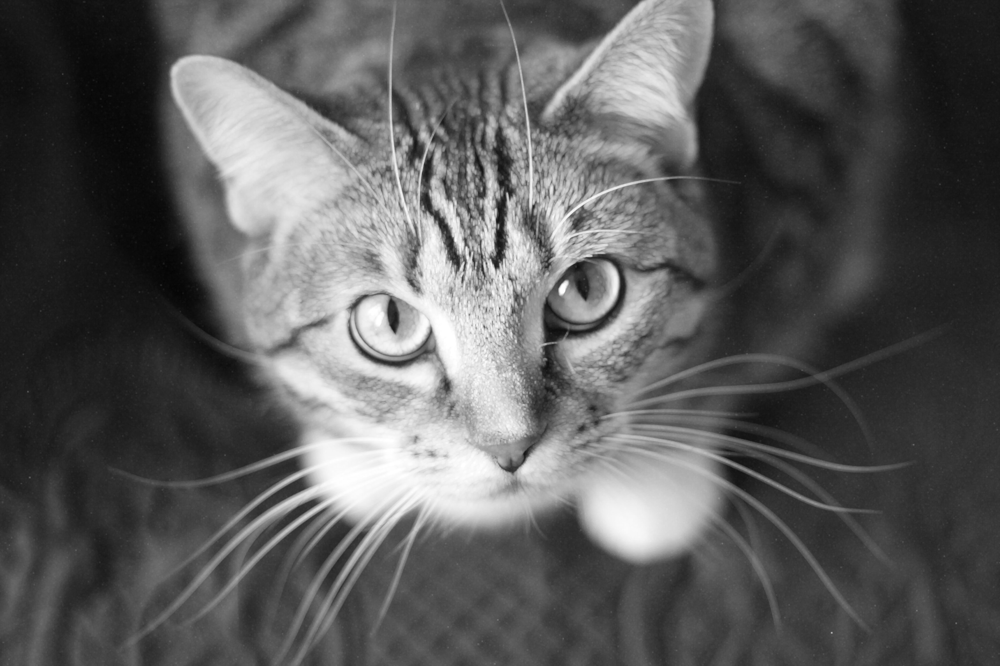

In [165]:
# Python program to demonstrate erosion and
# dilation of images.
import cv2
import numpy as np

# Reading the input image
img = cv2.imread('cat_image.jpg', 0)

# Taking a matrix of size 5 as the kernel
kernel = np.ones((5, 5), np.uint8)

# The first parameter is the original image,
# kernel is the matrix with which image is
# convolved and third parameter is the number
# of iterations, which will determine how much
# you want to erode/dilate a given image.
img_erosion = cv2.erode(img, kernel, iterations=1)
img_dilation = cv2.dilate(img, kernel, iterations=1)

cv2_imshow(img)
cv2_imshow(img_erosion)
cv2_imshow(img_dilation)

#TODO try opening and closing on your image